# **ViewFormer**: NeRF-free Neural Rendering from Few Images Using Transformers
[Jonáš Kulhánek](https://jkulhanek.github.io/), [Erik Derner](http://people.ciirc.cvut.cz/~derneeri/), [Torsten Sattler](https://tsattler.github.io/), [Robert Babuška](http://www.robertbabuska.com/)<br>

In this notebook, you can play with the pre-trained models and evaluate them on dataset samples. Start by running the first cell.

## Contents
- [InteriorNet image generation](#InteriorNet-image-generation)
- [Common Objects in 3D image generation](#Common-Objects-in-3D-image-generation)
- [ShapeNet image generation](#ShapeNet-image-generation)
- [Shepard-Metzler-Parts-7 image generation](#Shepard-Metzler-Parts-7-image-generation)
- [7-Scenes image generation](#7-Scenes-image-generation)
- [7-Scenes localization](#7-Scenes-localization)

In [1]:
# !pip install git+https://github.com/jkulhanek/viewformer.git  # Allow viewformer import
# !pip uninstall -y torchtext torchaudio  # Fix for Google Colab
# Hack to fix a bug with COLAB, does not happen locally
import viewformer.models.utils
setattr(viewformer.models.utils, 'load_lpips_model', lambda *args, **kwargs: None)
# End of hack
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [12, 8]

REMOTE_URL = 'https://data.ciirc.cvut.cz/public/projects/2022ViewFormer'
!export REMOTE_URL="https://data.ciirc.cvut.cz/public/projects/2022ViewFormer"

2023-05-02 00:37:35.450015: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-02 00:37:36.519398: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


# InteriorNet image generation
[back to top 🠕](#ViewFormer:-NeRF-free-Neural-Rendering-from-Few-Images-Using-Transformers)

In [2]:
# 
# Load dataset and models
#

# Prepare InteriorNet dataset sample
!mkdir -p /scratch/network/tmd4/viewformer/datasets/interiornet
# !curl -L -o  /scratch/network/tmd4/viewformer/datasets/interiornet.tar.gz $REMOTE_URL/datasets/interiornet.tar.gz
!tar -xzf /scratch/network/tmd4/viewformer/datasets/interiornet.tar.gz -C /scratch/network/tmd4/viewformer/datasets/interiornet
# For some resonse, in Google Colab we have to download the codebook model manually
!mkdir -p /scratch/network/tmd4/viewformer/models/interiornet-codebook-th
# !curl -L -o /scratch/network/tmd4/viewformer/models/interiornet-codebook-th.tar.gz $REMOTE_URL/checkpoints/interiornet-codebook-th.tar.gz
!tar -xzf /scratch/network/tmd4/viewformer/models/interiornet-codebook-th.tar.gz -C /scratch/network/tmd4/viewformer/models/interiornet-codebook-th

# Load InteriorNet dataset
from viewformer.data.loaders import DatasetLoader

test_loader = DatasetLoader(path=os.path.expanduser('/scratch/network/tmd4/viewformer/datasets/interiornet'), split='test')

# Load codebook and transformer models
from viewformer.utils.tensorflow import load_model

codebook = load_model(os.path.expanduser('/scratch/network/tmd4/viewformer/models/interiornet-codebook-th/model.ckpt'))
transformer = load_model('interiornet-transformer-tf')

2023-05-02 00:37:50.375937: W tensorflow/core/common_runtime/gpu/gpu_device.cc:1956] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...
2023-05-02 00:37:50.798731: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
the loaded model is a PyTorch checkpoint


Working with z of shape (1, 256, 8, 8) = 16384 dimensions.
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /home/tmd4/.conda/envs/viewformer/lib/python3.8/site-packages/lpips/weights/v0.1/vgg.pth


/home/tmd4/.conda/envs/viewformer/lib/python3.8/site-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
969MiB [01:27, 11.1MiB/s]                            


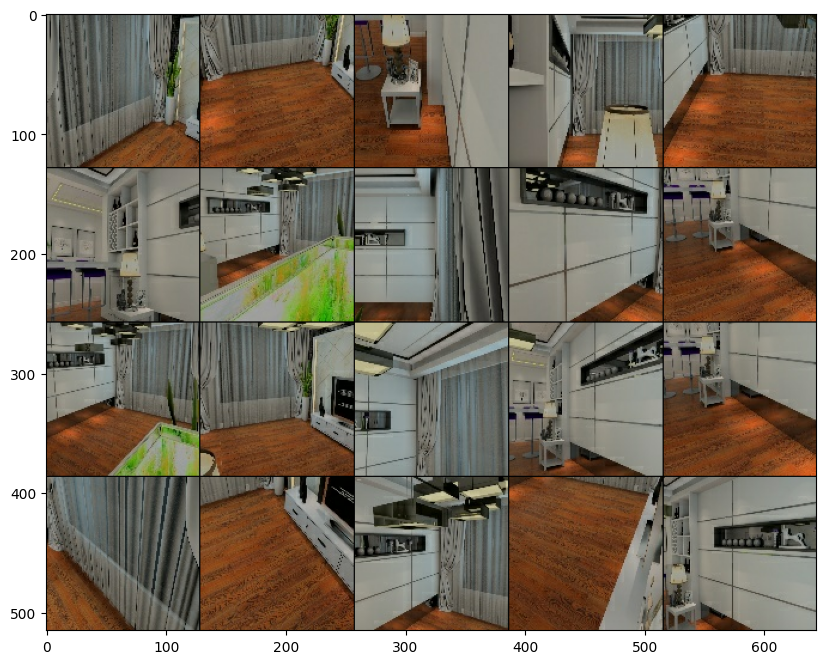

In [3]:
# Show InteriorNet sample
from viewformer.utils.visualization import np_imgrid

input_batch = test_loader[0]['frames'].astype('float32') / 255.
plt.imshow(np_imgrid(input_batch)[0])
plt.show()

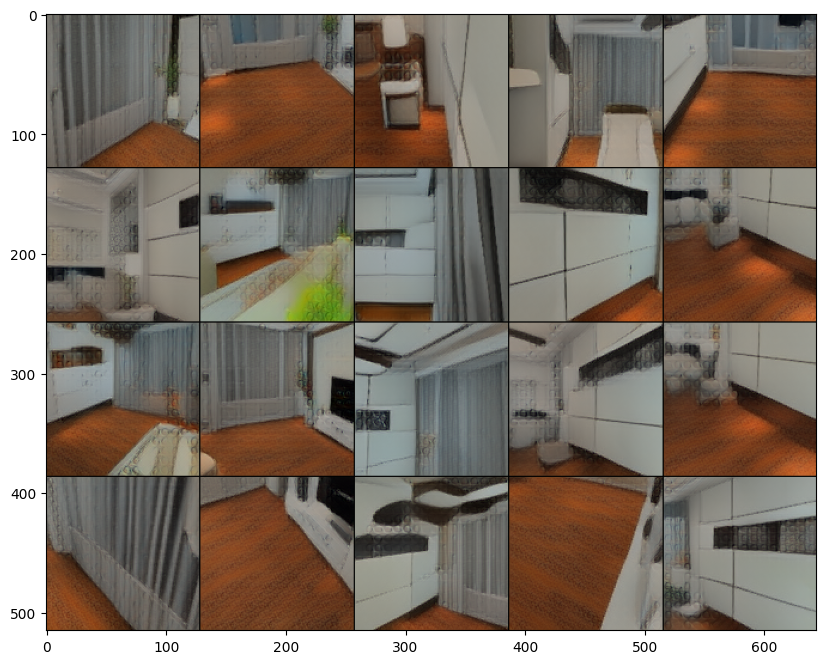

In [4]:
# Show codebook reconstruction
input_batch = test_loader[0]['frames'].astype('float32') / 255.
output_batch = np.clip(codebook(input_batch * 2 - 1)[0] / 2 + 0.5, 0, 1)

plt.imshow(np_imgrid(output_batch)[0])
plt.show()

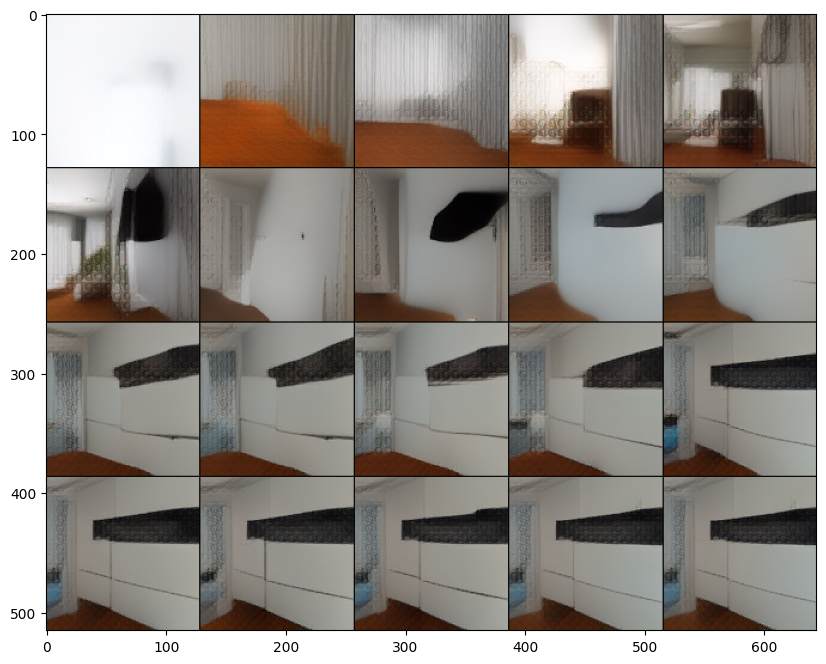

In [4]:
# Evaluate full pipeline with multiple context sizes
# Shows the last view with increasing context size
from viewformer.evaluate.evaluate_transformer_multictx import generate_batch_predictions
images, cameras = test_loader[0]['frames'][np.newaxis, ...], test_loader[0]['cameras'][np.newaxis, ...]
output = generate_batch_predictions(transformer, codebook, images, cameras)
plt.imshow(np_imgrid(output['generated_images'][0])[0])
plt.show()

## Common Objects in 3D image generation
[back to top 🠕](#ViewFormer:-NeRF-free-Neural-Rendering-from-Few-Images-Using-Transformers)

In [5]:
# 
# Load dataset and models
#

# Prepare CO3D dataset sample
!mkdir -p /scratch/network/tmd4/viewformer/datasets/co3d-apple
# !curl -L -o  /scratch/network/tmd4/viewformer/datasets/co3d-apple.tar.gz $REMOTE_URL/datasets/co3d-apple.tar.gz
!tar -xzf /scratch/network/tmd4/viewformer/datasets/co3d-apple.tar.gz -C /scratch/network/tmd4/viewformer/datasets/co3d-apple

# Load CO3D dataset
from viewformer.data.loaders import DatasetLoader

test_loader = DatasetLoader(path=os.path.expanduser('/scratch/network/tmd4/viewformer/datasets/co3d-apple'), split='val')

# Load codebook and transformer models
from viewformer.utils.tensorflow import load_model

codebook = load_model('co3d-10cat-codebook-th')
transformer = load_model('co3d-10cat-noloc-transformer-tf')

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  345k  100  345k    0     0   410k      0 --:--:-- --:--:-- --:--:--  409k


2023-05-02 00:40:20.049714: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
762MiB [00:56, 13.5MiB/s]                              
the loaded model is a PyTorch checkpoint


Working with z of shape (1, 256, 8, 8) = 16384 dimensions.
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /home/tmd4/.conda/envs/viewformer/lib/python3.8/site-packages/lpips/weights/v0.1/vgg.pth


968MiB [01:19, 12.2MiB/s]                            


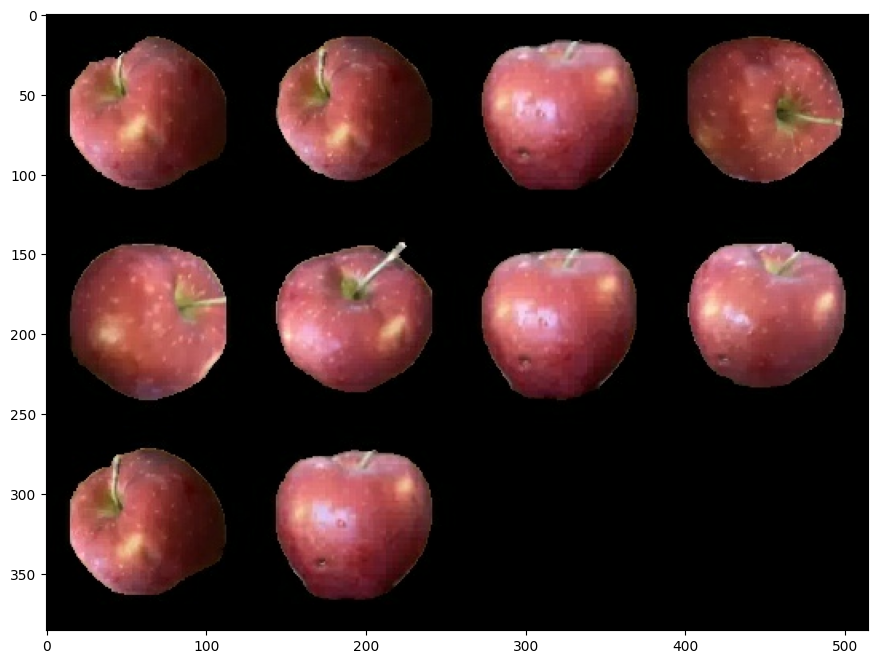

In [6]:
# Show dataset sample
from viewformer.utils.visualization import np_imgrid

input_batch = test_loader[0]['frames'][:10].astype('float32') / 255.
plt.imshow(np_imgrid(input_batch)[0])
plt.show()

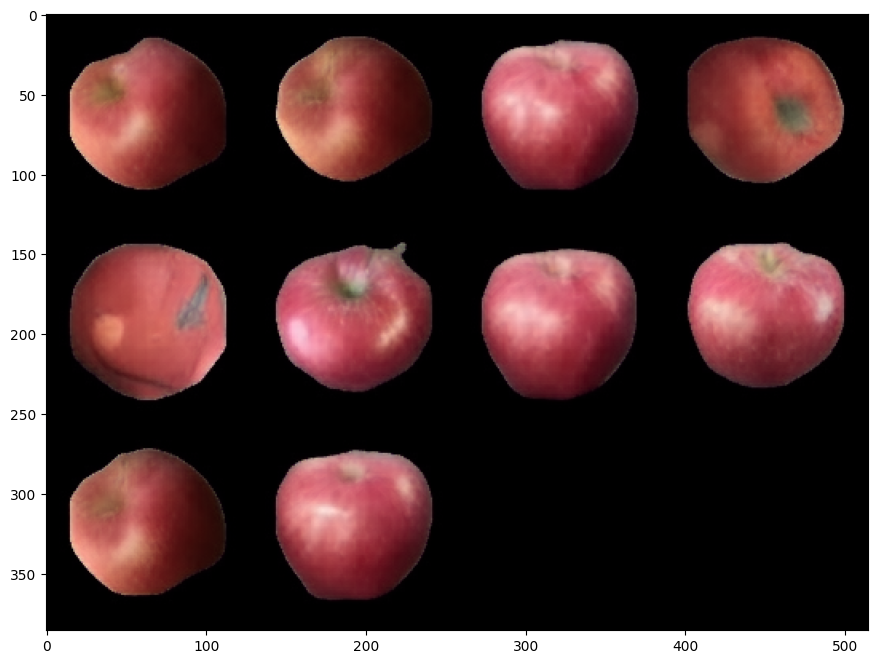

In [7]:
# Show codebook reconstruction
input_batch = test_loader[0]['frames'][:10].astype('float32') / 255.
output_batch = np.clip(codebook(input_batch * 2 - 1)[0] / 2 + 0.5, 0, 1)

plt.imshow(np_imgrid(output_batch)[0])
plt.show()

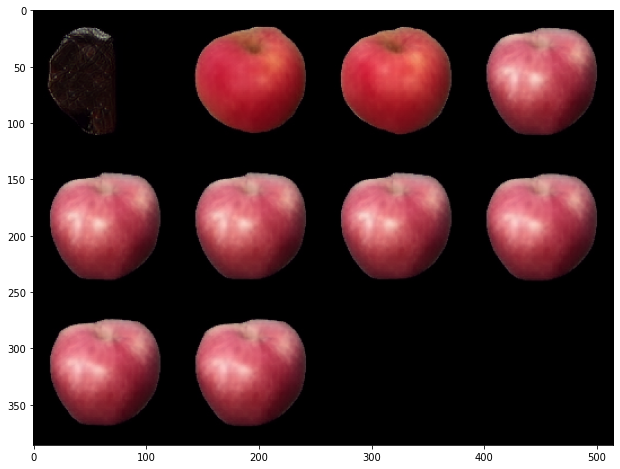

In [ ]:
# Evaluate full pipeline with multiple context sizes
# Shows the last view with increasing context size
from viewformer.evaluate.evaluate_transformer_multictx import generate_batch_predictions
images, cameras = test_loader[0]['frames'][np.newaxis, :10, ...], test_loader[0]['cameras'][np.newaxis, :10, ...]
output = generate_batch_predictions(transformer, codebook, images, cameras)
plt.imshow(np_imgrid(output['generated_images'][0])[0])
plt.show()

## ShapeNet image generation
[back to top 🠕](#ViewFormer:-NeRF-free-Neural-Rendering-from-Few-Images-Using-Transformers)

In [8]:
# 
# Load dataset and models
#

# Prepare ShapeNet dataset sample
!mkdir -p /scratch/network/tmd4/viewformer/datasets/shapenet-cars
# !curl -L -o  /scratch/network/tmd4/viewformer/datasets/shapenet-cars.tar.gz $REMOTE_URL/datasets/shapenet-cars.tar.gz
!tar -xzf /scratch/network/tmd4/viewformer/datasets/shapenet-cars.tar.gz -C /scratch/network/tmd4/viewformer/datasets/shapenet-cars

# Load ShapeNet dataset
from viewformer.data.loaders import DatasetLoader

test_loader = DatasetLoader(path=os.path.expanduser('/scratch/network/tmd4/viewformer/datasets/shapenet-cars'), split='test', shuffle=False)

# Load codebook and transformer models
from viewformer.utils.tensorflow import load_model

codebook = load_model('shapenet-srn-codebook-th')
transformer = load_model('shapenet-srn-transforner-tf')

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 13.9M  100 13.9M    0     0  4795k      0  0:00:02  0:00:02 --:--:-- 4794k


2023-05-02 00:43:25.484522: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
764MiB [00:52, 14.7MiB/s]                              
the loaded model is a PyTorch checkpoint


Working with z of shape (1, 256, 8, 8) = 16384 dimensions.
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /home/tmd4/.conda/envs/viewformer/lib/python3.8/site-packages/lpips/weights/v0.1/vgg.pth


972MiB [01:13, 13.3MiB/s]                              


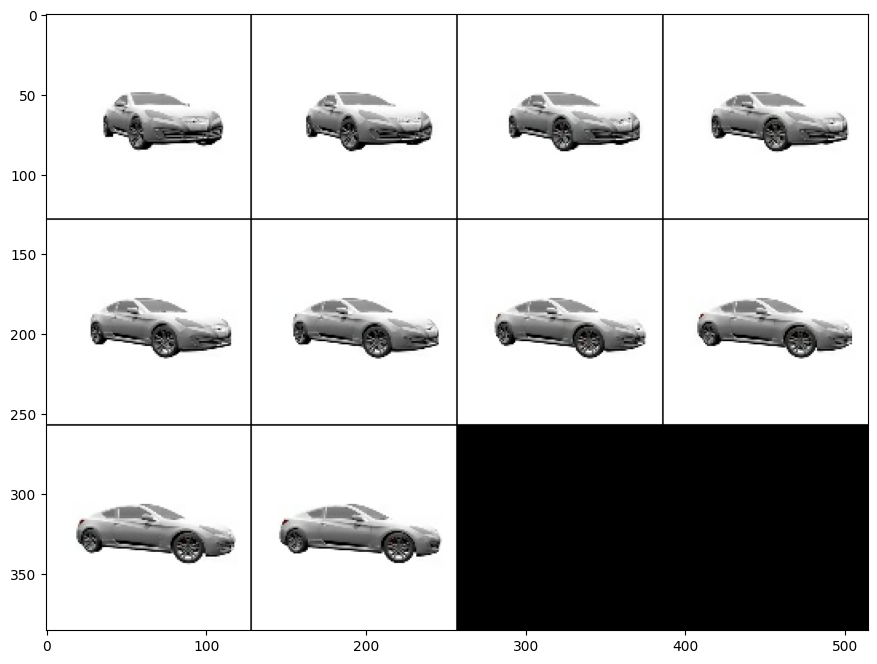

In [9]:
%matplotlib inline

# Show dataset sample
from viewformer.utils.visualization import np_imgrid

input_batch = test_loader[0]['frames'][:10].astype('float32') / 255.
plt.imshow(np_imgrid(input_batch)[0])
plt.show()

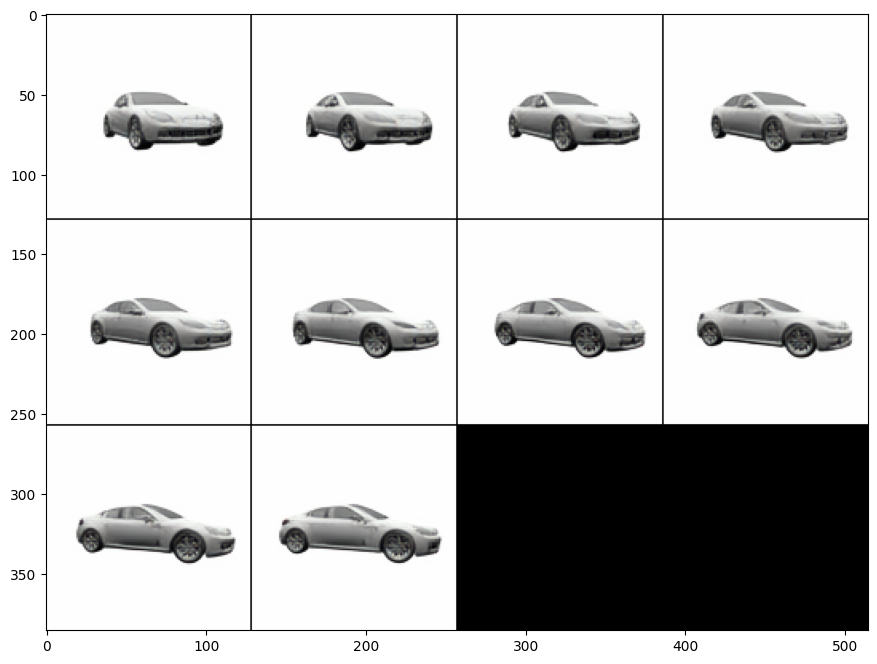

In [10]:
%matplotlib inline

# Show codebook reconstruction
input_batch = test_loader[0]['frames'][:10].astype('float32') / 255.
output_batch = np.clip(codebook(input_batch * 2 - 1)[0] / 2 + 0.5, 0, 1)

plt.imshow(np_imgrid(output_batch)[0])
plt.show()

In [11]:
# 9 mins + 50gb of gpu
# Evaluate full pipeline and generate all images for all context views
import viewformer.evaluate.evaluate_transformer_multictx_allimg as evaluate_allimg
import tensorflow as tf


seq = test_loader[0]
c_context_views = [64, 104, 144]
frames = np.array(seq['frames'])[np.newaxis, ...]
cameras = np.stack(seq['cameras'])[np.newaxis, ...].astype('float32')
frames, cameras = tf.convert_to_tensor(frames), tf.convert_to_tensor(cameras)
codes = evaluate_allimg.encode_images(frames, codebook_model=codebook)
generated_cameras, generated_codes = [], []
tcodes = np.concatenate([np.stack([codes[:, j] for j in c_context_views + [i]], 1) for i in range(len(seq['frames']))], 0)
tcameras = np.concatenate([np.stack([cameras[:, j] for j in c_context_views + [i]], 1) for i in range(len(seq['frames']))], 0)
generated_cameras, generated_codes = evaluate_allimg.run_with_batchsize(evaluate_allimg.transformer_predict, 128, tcameras, tcodes, transformer_model=transformer)
generated_images = evaluate_allimg.run_with_batchsize(evaluate_allimg.decode_code, 32, generated_codes, codebook_model=codebook)

2023-05-02 00:47:12.822409: W tensorflow/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 2105540608 exceeds 10% of free system memory.
2023-05-02 00:47:13.173519: W tensorflow/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 2105540608 exceeds 10% of free system memory.
2023-05-02 00:47:13.679893: W tensorflow/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 2105540608 exceeds 10% of free system memory.
2023-05-02 00:47:14.470663: W tensorflow/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 2105540608 exceeds 10% of free system memory.
2023-05-02 00:47:14.871242: W tensorflow/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 2105540608 exceeds 10% of free system memory.


In [12]:
%matplotlib inline
from matplotlib import rc
from matplotlib import animation
rc('animation', html='jshtml')

# Show video
fig = plt.figure(figsize=(8, 4))
p1, p2 = fig.subplots(1, 2)
i1 = p1.imshow(seq['frames'][0])
p1.set_title('GT', fontsize=16, y=-0.14)
p1.axis('off')
i2 = p2.imshow(generated_images[0, -1])
p2.set_title('generated image', fontsize=16, y=-0.14)
p2.axis('off')

def ani(index):
    i1.set_data(seq['frames'][index])
    i2.set_data(generated_images[index, -1])

animator = animation.FuncAnimation(fig, ani, frames=len(generated_images), interval=50, blit=False, repeat=True)
plt.close()
animator

## Shepard-Metzler-Parts-7 image generation
[back to top 🠕](#ViewFormer:-NeRF-free-Neural-Rendering-from-Few-Images-Using-Transformers)

In [13]:
# 
# Load dataset and models
#

# Prepare SM7 dataset sample
!mkdir -p /scratch/network/tmd4/viewformer/datasets/sm7
# !curl -L -o  /scratch/network/tmd4/viewformer/datasets/sm7.tar.gz $REMOTE_URL/datasets/sm7.tar.gz
!tar -xzf /scratch/network/tmd4/viewformer/datasets/sm7.tar.gz -C /scratch/network/tmd4/viewformer/datasets/sm7

# Load SM7 dataset
from viewformer.data.loaders import DatasetLoader

test_loader = DatasetLoader(path=os.path.expanduser('/scratch/network/tmd4/viewformer/datasets/sm7'), split='test')

# Load codebook and transformer models
from viewformer.utils.tensorflow import load_model

codebook = load_model('sm7-codebook-th')
transformer = load_model('sm7-transformer-tf')

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  153k  100  153k    0     0   202k      0 --:--:-- --:--:-- --:--:--  201k


2023-05-02 00:57:27.135127: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
766MiB [01:08, 11.2MiB/s]                              
the loaded model is a PyTorch checkpoint


Working with z of shape (1, 256, 8, 8) = 16384 dimensions.
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /home/tmd4/.conda/envs/viewformer/lib/python3.8/site-packages/lpips/weights/v0.1/vgg.pth


970MiB [01:20, 12.1MiB/s]                            


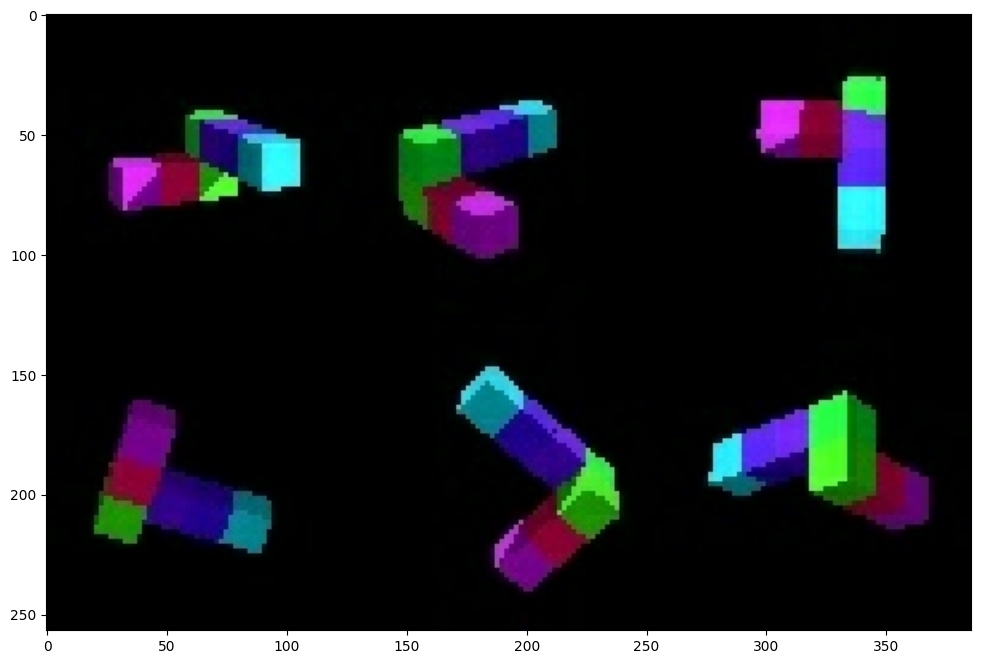

In [14]:
%matplotlib inline

# Show dataset sample
from viewformer.utils.visualization import np_imgrid

input_batch = test_loader[0]['frames'][:6].astype('float32') / 255.
plt.imshow(np_imgrid(input_batch)[0])
plt.show()

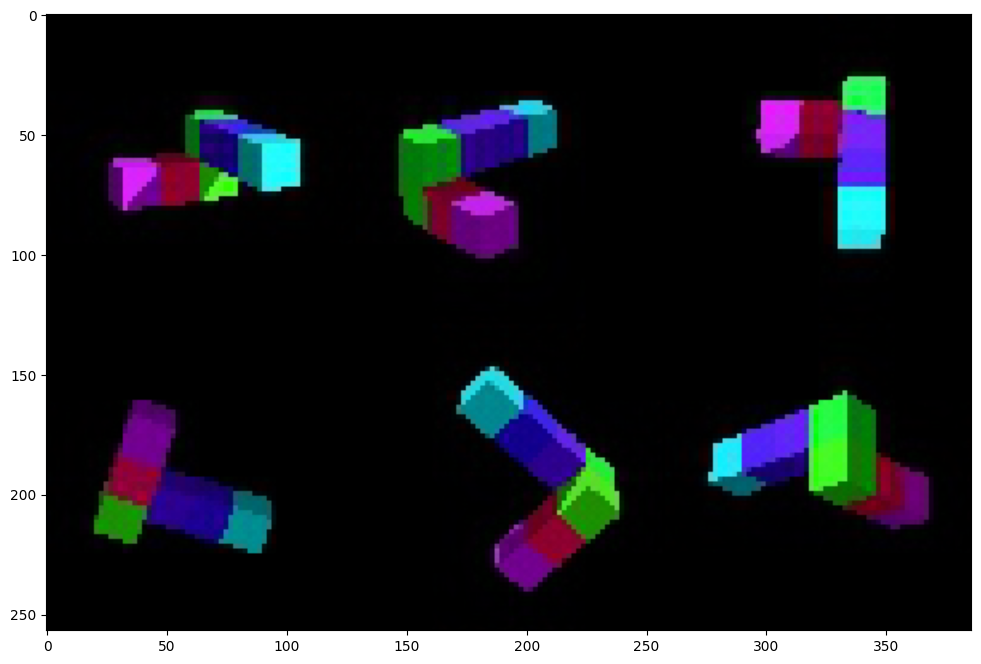

In [16]:
# Show codebook reconstruction
input_batch = test_loader[0]['frames'][:6].astype('float32') / 255.
output_batch = np.clip(codebook(input_batch * 2 - 1)[0] / 2 + 0.5, 0, 1)

plt.imshow(np_imgrid(output_batch)[0])
plt.show()

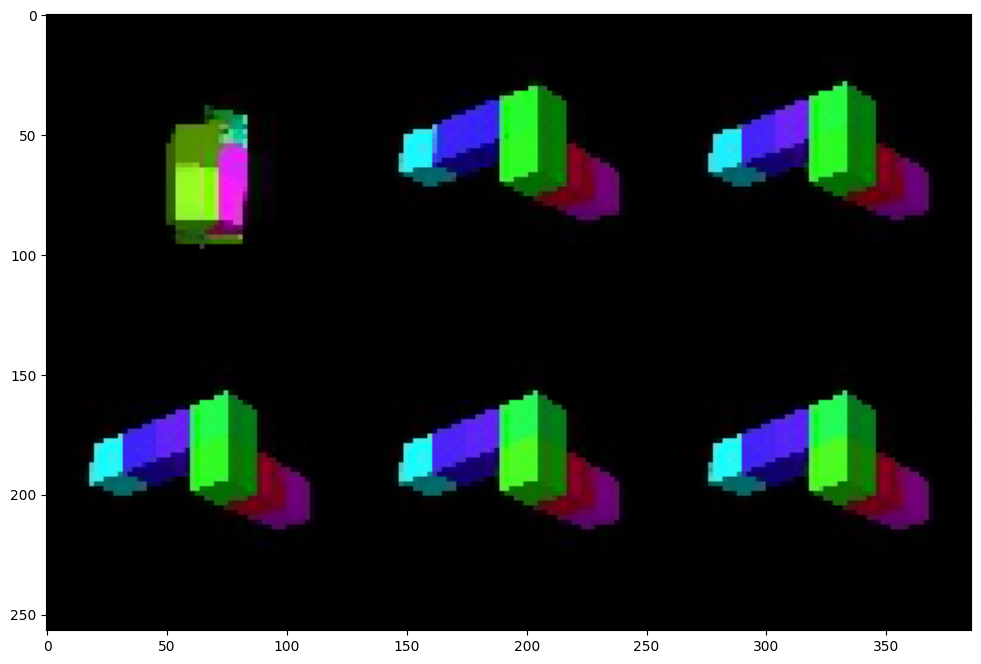

In [17]:
# Evaluate full pipeline with multiple context sizes
# Shows the last view with increasing context size
from viewformer.evaluate.evaluate_transformer_multictx import generate_batch_predictions
images, cameras = test_loader[0]['frames'][np.newaxis, :6, ...], test_loader[0]['cameras'][np.newaxis, :6, ...]
output = generate_batch_predictions(transformer, codebook, images, cameras)
plt.imshow(np_imgrid(output['generated_images'][0])[0])
plt.show()

# 7-Scenes image generation
[back to top 🠕](#ViewFormer:-NeRF-free-Neural-Rendering-from-Few-Images-Using-Transformers)

In [22]:
# 
# Load dataset and models
#

# Prepare 7-Scenes dataset sample
!mkdir -p /scratch/network/tmd4/viewformer/datasets/7scenes/chess
# !curl -L -o  /scratch/network/tmd4/viewformer/datasets/7scenes-chess.tar.gz $REMOTE_URL/datasets/7scenes-chess.tar.gz
!tar -xzf /scratch/network/tmd4/viewformer/datasets/7scenes-chess.tar.gz -C /scratch/network/tmd4/viewformer/datasets/7scenes/chess

# Load SM7 dataset
from viewformer.data.loaders import DatasetLoader

train_loader = DatasetLoader(path=os.path.expanduser('/scratch/network/tmd4/viewformer/datasets/7scenes/chess'), split='train')
test_loader = DatasetLoader(path=os.path.expanduser('/scratch/network/tmd4/viewformer/datasets/7scenes/chess'), split='test')

# Load codebook and transformer models
from viewformer.utils.tensorflow import load_model

codebook = load_model('7scenes-finetuned-interiornet-codebook-th')
transformer = load_model('7scenes-finetune-both-transformer-tf')

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  730k  100  730k    0     0   771k      0 --:--:-- --:--:-- --:--:--  770k


2023-05-02 01:06:51.587617: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2023-05-02 01:06:51.675044: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
the loaded model is a PyTorch checkpoint


Working with z of shape (1, 256, 8, 8) = 16384 dimensions.
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /home/tmd4/.conda/envs/viewformer/lib/python3.8/site-packages/lpips/weights/v0.1/vgg.pth


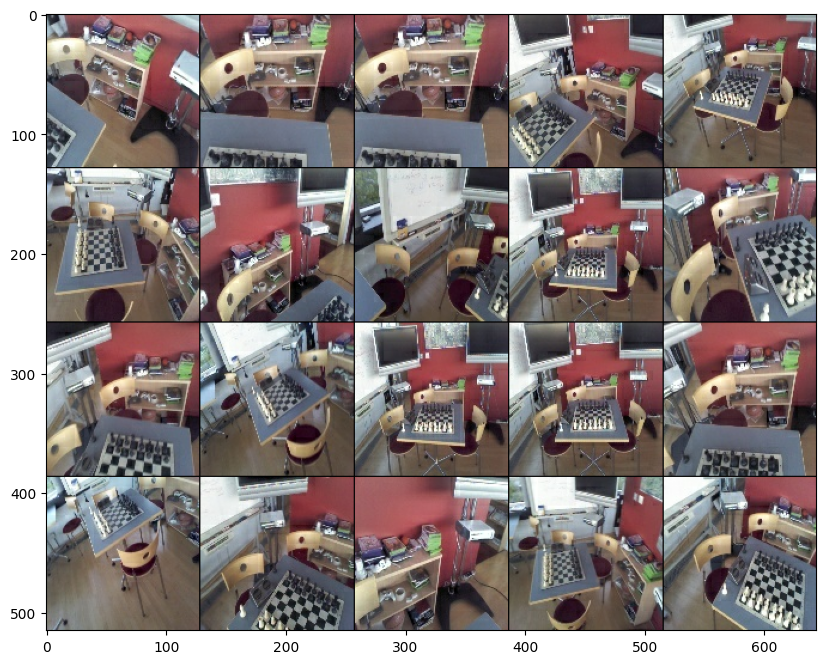

In [19]:
# Show dataset sample
from viewformer.utils.visualization import np_imgrid

input_batch = test_loader[0]['frames'].astype('float32') / 255.
plt.imshow(np_imgrid(input_batch)[0])
plt.show()

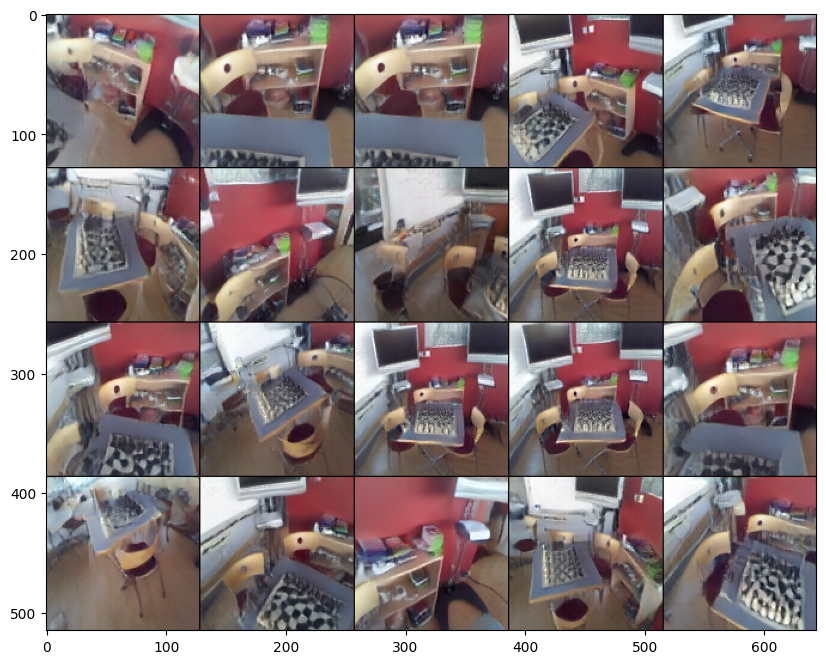

In [20]:
# Show codebook reconstruction
input_batch = test_loader[0]['frames'].astype('float32') / 255.
output_batch = np.clip(codebook(input_batch * 2 - 1)[0] / 2 + 0.5, 0, 1)

plt.imshow(np_imgrid(output_batch)[0])
plt.show()

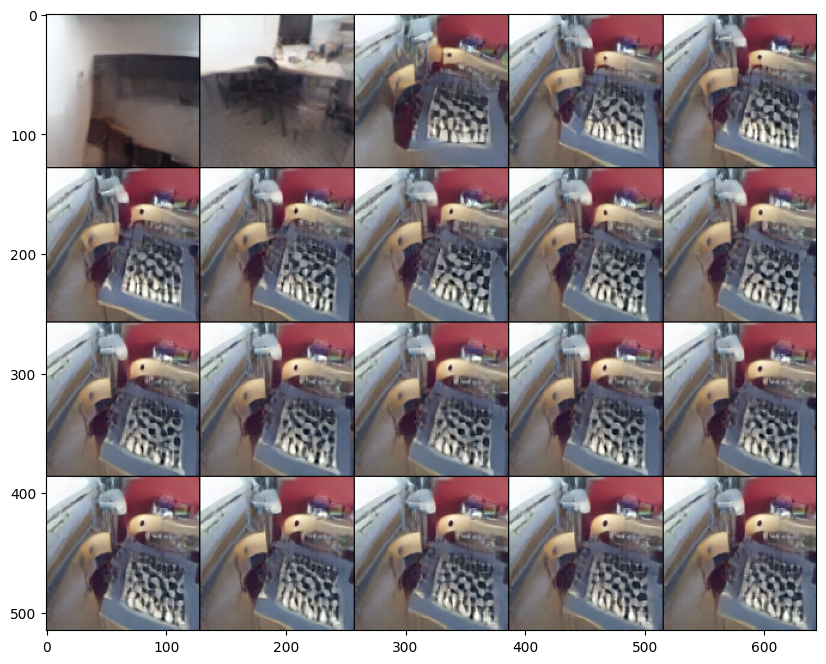

In [23]:
# Evaluate full pipeline with multiple context sizes
# Shows the last view with increasing context size
from viewformer.evaluate.evaluate_transformer_multictx import generate_batch_predictions

images, cameras = train_loader[0]['frames'][np.newaxis, :19, ...], train_loader[0]['cameras'][np.newaxis, :19, ...]
images = np.concatenate([images, test_loader[0]['frames'][np.newaxis, 19:20]], 1)
cameras = np.concatenate([cameras, test_loader[0]['cameras'][np.newaxis, 19:20]], 1)
output = generate_batch_predictions(transformer, codebook, images, cameras)
plt.imshow(np_imgrid(output['generated_images'][0])[0])
plt.show()

# 7-Scenes localization
[back to top 🠕](#ViewFormer:-NeRF-free-Neural-Rendering-from-Few-Images-Using-Transformers)

In [24]:
# 
# Load dataset and models
#

# Prepare 7-Scenes dataset sample
!mkdir -p /scratch/network/tmd4/viewformer/datasets/7scenes/chess
# !curl -L -o  /scratch/network/tmd4/viewformer/datasets/7scenes-chess.tar.gz $REMOTE_URL/datasets/7scenes-chess.tar.gz
!tar -xzf /scratch/network/tmd4/viewformer/datasets/7scenes-chess.tar.gz -C /scratch/network/tmd4/viewformer/datasets/7scenes/chess

# Load SM7 dataset
from viewformer.data.loaders import DatasetLoader

test_loader = DatasetLoader(path=os.path.expanduser('/scratch/network/tmd4/viewformer/datasets/7scenes/chess'), split='test')

# Load codebook and transformer models
from viewformer.utils.tensorflow import load_model

codebook = load_model('7scenes-finetuned-interiornet-codebook-th')
transformer = load_model('7scenes-finetune-both-transformer-tf')

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  730k  100  730k    0     0   771k      0 --:--:-- --:--:-- --:--:--  771k


2023-05-02 01:08:07.747336: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
the loaded model is a PyTorch checkpoint


Working with z of shape (1, 256, 8, 8) = 16384 dimensions.
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /home/tmd4/.conda/envs/viewformer/lib/python3.8/site-packages/lpips/weights/v0.1/vgg.pth


In [25]:
# Evaluate full pipeline with multiple context sizes
# Prints difference between the predicted pose and ground truth for each context size
# It shows the difference in x, y, z and the difference between the GT and predicted quaternion (w, a, b, c)
from viewformer.evaluate.evaluate_transformer_multictx import generate_batch_predictions
from IPython.display import HTML, display

images, cameras = train_loader[0]['frames'][np.newaxis, :19, ...], train_loader[0]['cameras'][np.newaxis, :19, ...]
images = np.concatenate([images, test_loader[0]['frames'][np.newaxis, 19:20]], 1)
cameras = np.concatenate([cameras, test_loader[0]['cameras'][np.newaxis, 19:20]], 1)
output = generate_batch_predictions(transformer, codebook, images, cameras)

# Show the table
data = (output['ground_truth_cameras'] - output['generated_cameras'])[0]
display(HTML('''
<table><thead><tr>
<td>ctx. size</td>
<td>x</td>
<td>y</td>
<td>z</td>
<td>w</td>
<td>a</td>
<td>b</td>
<td>c</td>
</tr></thead><tbody>''' +
''.join(f'<tr><td>ctx: {i}</td>' +
        ''.join(f'<td>{cell:.2f}</td>' for cell in row) +
'</tr>'
for i, row in enumerate(data))
+ '''
</tbody></table>'''))

ctx. size,x,y,z,w,a,b,c
ctx: 0,-0.37,-0.04,-0.92,0.25,0.23,0.35,-0.01
ctx: 1,1.02,-0.03,-1.24,0.05,0.11,-0.41,-0.10
ctx: 2,-0.01,0.16,-0.04,0.02,0.08,-0.01,-0.02
ctx: 3,-0.10,0.00,-0.10,0.01,0.03,0.02,-0.02
ctx: 4,-0.08,-0.01,-0.08,0.01,0.03,0.01,-0.02
ctx: 5,-0.10,-0.00,-0.09,0.01,0.03,0.02,-0.03
ctx: 6,-0.10,-0.01,-0.07,0.01,0.03,0.02,-0.02
ctx: 7,-0.10,0.00,-0.05,0.01,0.03,0.03,-0.01
ctx: 8,-0.09,-0.00,-0.05,0.01,0.03,0.02,-0.01
ctx: 9,-0.08,-0.02,-0.03,0.01,0.02,0.02,-0.00
